In [1]:
1+1

2

# We are exploring the S&P 500 market index using basic time series analysis techniques just for fun.

We will test the exponential fit by fitting a regression line to the log transform and predict the upcoming cusp as of Mar 30 2024


In [2]:
# %pip install yfinance pandas seaborn matplotlib numpy statsmodels scipy scikit-learn dtale ipykernel ipywidgets bokeh jupyter_bokeh pandas_bokeh

In [3]:
# Importing the libraries, setting up the environment and downloading the data

import yfinance as yf
from datetime import date
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from sklearn.linear_model import LinearRegression
import dtale
from bokeh.plotting import figure, show, output_file, save
from bokeh.models import ColumnDataSource, NumeralTickFormatter, HoverTool, CrosshairTool
from bokeh.io import output_notebook

#import today's date
today = date.today()



# Setting up boken for jupyter notebook otuput instead of browser
# output_notebook()



# Downloading S&P 500 data from Yahoo Finance
df = yf.download('^GSPC', '1931-01-01', today, auto_adjust=True)

#write df to a csv file
df.to_csv(f'data/{today}_sp500.csv')

#write df to a pickle file with seconds in time to make it unique
now = pd.Timestamp.now()
df.to_pickle(f'data/{today}_sp500_{now}.pkl')
df

[*********************100%%**********************]  1 of 1 completed


,Open,High,Low,Close,Volume
Date,,,,,
1931-01-02,15.850000,15.850000,15.850000,15.850000,0
1931-01-05,15.930000,15.930000,15.930000,15.930000,0
1931-01-06,16.129999,16.129999,16.129999,16.129999,0
1931-01-07,15.090000,15.090000,15.090000,15.090000,0
1931-01-08,16.230000,16.230000,16.230000,16.230000,0
...,...,...,...,...,...
2024-04-08,5211.370117,5219.569824,5197.350098,5202.390137,3278180000
2024-04-09,5217.029785,5224.810059,5160.779785,5209.910156,3400680000
2024-04-10,5167.879883,5178.430176,5138.700195,5160.640137,3845930000


In [4]:
#read the csv file and use the Date column as index
df= pd.read_csv(f'data/{today}_sp500.csv', index_col='Date', parse_dates=True)
df['Day']= df.index
# convert the datetime index to ordinal values, which can be used to plot a regression line
df.index = df.index.map(pd.Timestamp.toordinal)

# Logarithmic transformation (assuming positive 'Close' values)
df['Log_Close'] = np.log(df['Close'])  

display(df.iloc[:, :])

,Open,High,Low,Close,Volume,Day,Log_Close
Date,,,,,,,
704919,15.850000,15.850000,15.850000,15.850000,0,1931-01-02,2.763170
704922,15.930000,15.930000,15.930000,15.930000,0,1931-01-05,2.768204
704923,16.129999,16.129999,16.129999,16.129999,0,1931-01-06,2.780681
704924,15.090000,15.090000,15.090000,15.090000,0,1931-01-07,2.714032
704925,16.230000,16.230000,16.230000,16.230000,0,1931-01-08,2.786861
...,...,...,...,...,...,...,...
738984,5211.370117,5219.569824,5197.350098,5202.390137,3278180000,2024-04-08,8.556873
738985,5217.029785,5224.810059,5160.779785,5209.910156,3400680000,2024-04-09,8.558318
738986,5167.879883,5178.430176,5138.700195,5160.640137,3845930000,2024-04-10,8.548816


## Fitting the regression line

In [5]:
# convert the regression line start date to ordinal
x1 = pd.to_datetime('1932-01-01').toordinal()

# data slice for the regression line
data=df.loc[x1:].reset_index()

# create a linear regression model
model = LinearRegression()

# fit the model
model.fit(data[['Date']], data['Log_Close'])

slope = model.coef_[0]
intercept = model.intercept_
R2 = model.score(data[['Date']], data['Log_Close'])

equation = f'Lin_Regr_Log_Close = {slope:.4f} * Date {'+' if intercept >=0 else ''}{intercept:.4f}'


# make predictions
data['Linear'] = model.predict(data[['Date']])
data['Prediction_of_Close'] = np.exp(data['Linear'])



#print the model details including the slope, intercept, r-squared, and p-value, etc.
print('Slope:', slope)
print('Intercept:', intercept)
print('R-squared:', R2)

equation = f'Lin_Regr_Log_Close = {slope:.4f}*Date{'+' if intercept >=0 else ''}{intercept:.4f}'
print('The equation of the regression line is:', equation)

Slope: 0.00019020242831120106
Intercept: -132.29824594228864
R-squared: 0.9778233013518045
The equation of the regression line is: Lin_Regr_Log_Close = 0.0002*Date-132.2982


In [6]:
#Display the data
display(data.iloc[:, :])

,Date,Open,High,Low,Close,Volume,Day,Log_Close,Linear,Prediction_of_Close
0,705286,7.560000,7.560000,7.560000,7.560000,0,1932-01-04,2.022871,1.848864,6.352598
1,705287,7.550000,7.550000,7.550000,7.550000,0,1932-01-05,2.021548,1.849054,6.353807
2,705288,8.080000,8.080000,8.080000,8.080000,0,1932-01-06,2.089392,1.849244,6.355015
3,705289,8.220000,8.220000,8.220000,8.220000,0,1932-01-07,2.106570,1.849435,6.356224
4,705290,8.570000,8.570000,8.570000,8.570000,0,1932-01-08,2.148268,1.849625,6.357433
...,...,...,...,...,...,...,...,...,...,...
23178,738984,5211.370117,5219.569824,5197.350098,5202.390137,3278180000,2024-04-08,8.556873,8.258305,3859.547937
23179,738985,5217.029785,5224.810059,5160.779785,5209.910156,3400680000,2024-04-09,8.558318,8.258496,3860.282102
23180,738986,5167.879883,5178.430176,5138.700195,5160.640137,3845930000,2024-04-10,8.548816,8.258686,3861.016407
23181,738987,5172.950195,5211.779785,5138.770020,5199.060059,3509380000,2024-04-11,8.556233,8.258876,3861.750852


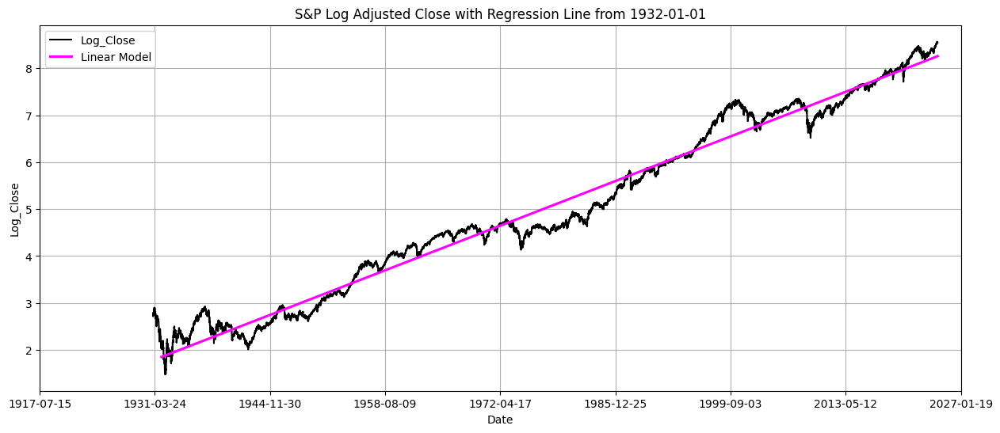

In [7]:

# convert the regression line start date to ordinal
x1 = pd.to_datetime('1932-01-01').toordinal()

# data slice for the regression line
data_sn=df.loc[x1:].reset_index()

# plot the log Close data
ax1 = df.plot(y='Log_Close', c='k', figsize=(15, 6), grid=True, legend=False,
              title='S&P Log Adjusted Close with Regression Line from 1932-01-01')

# add a regression line
sns.regplot(data=data_sn, x='Date', y='Log_Close', ax=ax1, color='magenta', scatter_kws={'s': 7}, label='Linear Model', scatter=False)

ax1.set_xlim(df.index[0], df.index[-1])

# convert the axis back to datetime
xticks = ax1.get_xticks()
labels = [pd.Timestamp.fromordinal(int(label)).date() for label in xticks]
ax1.set_xticks(xticks)
ax1.set_xticklabels(labels)

ax1.legend()

plt.show()

Plot in seaborn

## Making a dynamic version of the plot using Bokeh

In [8]:
display(data.iloc[:, :])

,Date,Open,High,Low,Close,Volume,Day,Log_Close,Linear,Prediction_of_Close
0,705286,7.560000,7.560000,7.560000,7.560000,0,1932-01-04,2.022871,1.848864,6.352598
1,705287,7.550000,7.550000,7.550000,7.550000,0,1932-01-05,2.021548,1.849054,6.353807
2,705288,8.080000,8.080000,8.080000,8.080000,0,1932-01-06,2.089392,1.849244,6.355015
3,705289,8.220000,8.220000,8.220000,8.220000,0,1932-01-07,2.106570,1.849435,6.356224
4,705290,8.570000,8.570000,8.570000,8.570000,0,1932-01-08,2.148268,1.849625,6.357433
...,...,...,...,...,...,...,...,...,...,...
23178,738984,5211.370117,5219.569824,5197.350098,5202.390137,3278180000,2024-04-08,8.556873,8.258305,3859.547937
23179,738985,5217.029785,5224.810059,5160.779785,5209.910156,3400680000,2024-04-09,8.558318,8.258496,3860.282102
23180,738986,5167.879883,5178.430176,5138.700195,5160.640137,3845930000,2024-04-10,8.548816,8.258686,3861.016407
23181,738987,5172.950195,5211.779785,5138.770020,5199.060059,3509380000,2024-04-11,8.556233,8.258876,3861.750852


In [9]:
# adding column selection to the plot_regression_line function
def plot_regression_line(data, equation, title='S&P 500 Index (1931-2024)', cols=['Day', 'Log_Close', 'Linear'], if_notebook=True, if_save=False, filename='Regression_Line.html'):
    # Create a new figure
    p = figure(title=title, x_axis_label='Year', y_axis_label='Log S&P 500 Index', width=1000, height=600, x_axis_type='datetime')

    # Define the source variable
    source = ColumnDataSource(data=data)

    # Define the colors for the lines
    colors = ['blue', 'red', 'green', 'orange', 'purple']  # Add more colors if needed

    # Plot the lines
    for i in range(1, len(cols)):
        p.line(x=cols[0], y=cols[i], source=source, line_width=2, legend_label=cols[i], color=colors[i-1])  # Use different color for each line

    # Add hover functionality from the list of columns
    tooltips = [(cols[0], '@' + cols[0] + '{%F}')]
    for i in range(1, len(cols)):
        tooltips.extend([(cols[i], '@' + cols[i] + '{0,0.00}')])
    hover_tool = HoverTool(tooltips=tooltips, formatters={'@' + cols[0]: 'datetime'})

    # hover_tool = HoverTool(tooltips=[('Year', '@' + cols[0] + '{%F}'), (cols[1], '@' + cols[1] + '{0,0.00}'), (cols[2], '@' + cols[2] + '{0,0.00}')], formatters={'@' + cols[0]: 'datetime'})
    p.add_tools(hover_tool)

    # Add the equation of the regression line
    # p.text(x=400 , y=0.5, text=[equation], text_font_size='18pt', text_align='center')

    # Format the y-axis tick labels
    p.yaxis.formatter = NumeralTickFormatter(format='0,0.00')

    # Relocate the legend to top left
    p.legend.location = 'top_left'

    

    # Show the plot
    if if_notebook:
        output_notebook()
        show(p)
    else:
        show(p)

    # Save the plot
    if if_save:
        output_file(filename, title=title)
        save(p)
        print(f'The plot is saved as {filename}.')
    else:
        print('The plot is displayed in the notebook.')

    return p


plot_regression_line(data, equation, title='S&P 500 Index (1931-2024)', cols=['Day', 'Log_Close', 'Linear'], if_notebook=True, if_save=False, filename='Regression_Line.html')



Loading BokehJS ...

The plot is displayed in the notebook.


figure(id='p1001', ...)

We extend daily till year_future year and predict 

In [10]:
data['Day'].max()
plot_regression_line(data.loc[data['Day'] >= pd.to_datetime('1950-01-01')], equation, title='S&P 500 Index (1931-2024)', cols=['Day', 'Log_Close', 'Linear'])

Loading BokehJS ...

The plot is displayed in the notebook.


figure(id='p1084', ...)

In [11]:
#We extend daily intil the year year_future forward  
# create a new dataframe for the future dates
day = 1  # Define the value of 'day' variable here

year_future = 2030

# convert the 'Day' column to datetime
data['Day'] = pd.to_datetime(data['Day'])

delta_years = year_future - data['Day'].max().year
future_dates = pd.date_range(start=data['Day'].max()+pd.DateOffset(days=1) , periods=delta_years*365, freq='D')


print(future_dates)

# convert the future dates to ordinal
future_dates_od = future_dates.map(pd.Timestamp.toordinal)
print(future_dates_od)

# convert future_dates to a numpy array
future_dates_od_np = np.array(future_dates_od)
print(future_dates_od_np)


#create a new dataframe for the future dates and add above 3 columns
future_data = pd.DataFrame(future_dates, columns=['Day'])
future_data['Day_od'] = future_dates_od

#predict the S&P 500 index using the linear regression model and add to the dataframe
future_data['Linear'] = model.predict(future_dates_od_np.reshape(-1, 1))
future_data['Prediction_of_Close'] = np.exp(future_data['Linear'])

future_data.index=future_data['Day_od']

display(future_data.iloc[:, :])

DatetimeIndex(['2024-04-13', '2024-04-14', '2024-04-15', '2024-04-16',
               '2024-04-17', '2024-04-18', '2024-04-19', '2024-04-20',
               '2024-04-21', '2024-04-22',
               ...
               '2030-04-02', '2030-04-03', '2030-04-04', '2030-04-05',
               '2030-04-06', '2030-04-07', '2030-04-08', '2030-04-09',
               '2030-04-10', '2030-04-11'],
              dtype='datetime64[ns]', length=2190, freq='D')
Index([738989, 738990, 738991, 738992, 738993, 738994, 738995, 738996, 738997,
       738998,
       ...
       741169, 741170, 741171, 741172, 741173, 741174, 741175, 741176, 741177,
       741178],
      dtype='int64', length=2190)
[738989 738990 738991 ... 741176 741177 741178]


/Users/norayr/.pyenv/versions/3.12.0/envs/Market/lib/python3.12/site-packages/sklearn/base.py:493: UserWarning:

X does not have valid feature names, but LinearRegression was fitted with feature names



,Day,Day_od,Linear,Prediction_of_Close
Day_od,,,,
738989,2024-04-13,738989,8.259256,3863.220160
738990,2024-04-14,738990,8.259447,3863.955024
738991,2024-04-15,738991,8.259637,3864.690027
738992,2024-04-16,738992,8.259827,3865.425170
738993,2024-04-17,738993,8.260017,3866.160454
...,...,...,...,...
741174,2030-04-07,741174,8.674849,5853.813797
741175,2030-04-08,741175,8.675039,5854.927312
741176,2030-04-09,741176,8.675229,5856.041039


In [13]:
# Concatenate the original data frame and the future data frame
extended_df = pd.concat([df, future_data[['Day', 'Prediction_of_Close']]])

# add day ordinal to the extended dataframe
extended_df['Day_od'] = extended_df['Day'].apply(pd.to_datetime).apply(pd.Timestamp.toordinal)

# add the regression line to the extended dataframe
extended_df['Linear'] = model.predict(np.array(extended_df[['Day_od']]).reshape(-1, 1))

# add the prediction of the close to the extended dataframe
extended_df['Prediction_of_Close'] = np.exp(extended_df['Linear'])

# Display the extended data frame
display(extended_df.iloc[:, :])

/Users/norayr/.pyenv/versions/3.12.0/envs/Market/lib/python3.12/site-packages/sklearn/base.py:493: UserWarning:

X does not have valid feature names, but LinearRegression was fitted with feature names



,Open,High,Low,Close,Volume,Day,Log_Close,Prediction_of_Close,Day_od,Linear
704919,15.850000,15.850000,15.850000,15.850000,0.0,1931-01-02,2.763170,5.924283,704919,1.779060
704922,15.930000,15.930000,15.930000,15.930000,0.0,1931-01-05,2.768204,5.927664,704922,1.779630
704923,16.129999,16.129999,16.129999,16.129999,0.0,1931-01-06,2.780681,5.928792,704923,1.779820
704924,15.090000,15.090000,15.090000,15.090000,0.0,1931-01-07,2.714032,5.929919,704924,1.780011
704925,16.230000,16.230000,16.230000,16.230000,0.0,1931-01-08,2.786861,5.931047,704925,1.780201
...,...,...,...,...,...,...,...,...,...,...
741174,NaN,NaN,NaN,NaN,NaN,2030-04-07,NaN,5853.813797,741174,8.674849
741175,NaN,NaN,NaN,NaN,NaN,2030-04-08,NaN,5854.927312,741175,8.675039
741176,NaN,NaN,NaN,NaN,NaN,2030-04-09,NaN,5856.041039,741176,8.675229
741177,NaN,NaN,NaN,NaN,NaN,2030-04-10,NaN,5857.154978,741177,8.675419


In [14]:
# Show data +- 5 days from today
delta_days = 5

date_range = (extended_df['Day'] > pd.to_datetime(today) - pd.DateOffset(days=delta_days)) & (extended_df['Day'] < pd.to_datetime(today) + pd.DateOffset(days=delta_days))

display(extended_df.loc[date_range].iloc[:, :])



,Open,High,Low,Close,Volume,Day,Log_Close,Prediction_of_Close,Day_od,Linear
738985,5217.029785,5224.810059,5160.779785,5209.910156,3.400680e+09,2024-04-09,8.558318,3860.282102,738985,8.258496
738986,5167.879883,5178.430176,5138.700195,5160.640137,3.845930e+09,2024-04-10,8.548816,3861.016407,738986,8.258686
738987,5172.950195,5211.779785,5138.770020,5199.060059,3.509380e+09,2024-04-11,8.556233,3861.750852,738987,8.258876
738988,5171.509766,5175.029785,5107.939941,5123.410156,3.963220e+09,2024-04-12,8.541576,3862.485436,738988,8.259066
738989,NaN,NaN,NaN,NaN,NaN,2024-04-13,NaN,3863.220160,738989,8.259256
738990,NaN,NaN,NaN,NaN,NaN,2024-04-14,NaN,3863.955024,738990,8.259447
738991,NaN,NaN,NaN,NaN,NaN,2024-04-15,NaN,3864.690027,738991,8.259637
738992,NaN,NaN,NaN,NaN,NaN,2024-04-16,NaN,3865.425170,738992,8.259827
738993,NaN,NaN,NaN,NaN,NaN,2024-04-17,NaN,3866.160454,738993,8.260017


In [15]:
#display the data from 1950 to 2026
data_1950_2026 = extended_df.loc[extended_df['Day'] >= pd.to_datetime('1950-01-01')]
display(data_1950_2026.iloc[:, :])
plot_regression_line(data_1950_2026, equation, title='S&P 500 Index (1931-2024)', cols=['Day', 'Log_Close', 'Linear'])

,Open,High,Low,Close,Volume,Day,Log_Close,Prediction_of_Close,Day_od,Linear
711860,16.66,16.66,16.66,16.66,1260000.0,1950-01-03,2.813011,22.181413,711860,3.099255
711861,16.85,16.85,16.85,16.85,1890000.0,1950-01-04,2.824351,22.185632,711861,3.099445
711862,16.93,16.93,16.93,16.93,2550000.0,1950-01-05,2.829087,22.189852,711862,3.099635
711863,16.98,16.98,16.98,16.98,2010000.0,1950-01-06,2.832036,22.194073,711863,3.099825
711866,17.08,17.08,17.08,17.08,2520000.0,1950-01-09,2.837908,22.206741,711866,3.100396
...,...,...,...,...,...,...,...,...,...,...
741174,NaN,NaN,NaN,NaN,NaN,2030-04-07,NaN,5853.813797,741174,8.674849
741175,NaN,NaN,NaN,NaN,NaN,2030-04-08,NaN,5854.927312,741175,8.675039
741176,NaN,NaN,NaN,NaN,NaN,2030-04-09,NaN,5856.041039,741176,8.675229
741177,NaN,NaN,NaN,NaN,NaN,2030-04-10,NaN,5857.154978,741177,8.675419


Loading BokehJS ...

The plot is displayed in the notebook.


figure(id='p1167', ...)

In [16]:
# plotting the extended data frame using the plot_regression_line function
plot_regression_line(extended_df, equation, title=f'S&P 500 Index (1931-{year_future})', cols = ['Day', 'Close', 'Prediction_of_Close'], if_save=False, filename='Prediction_2030_S&P_500_Index.html')


Loading BokehJS ...

The plot is saved as Prediction_2030_S&P_500_Index.html.


figure(id='p1251', ...)

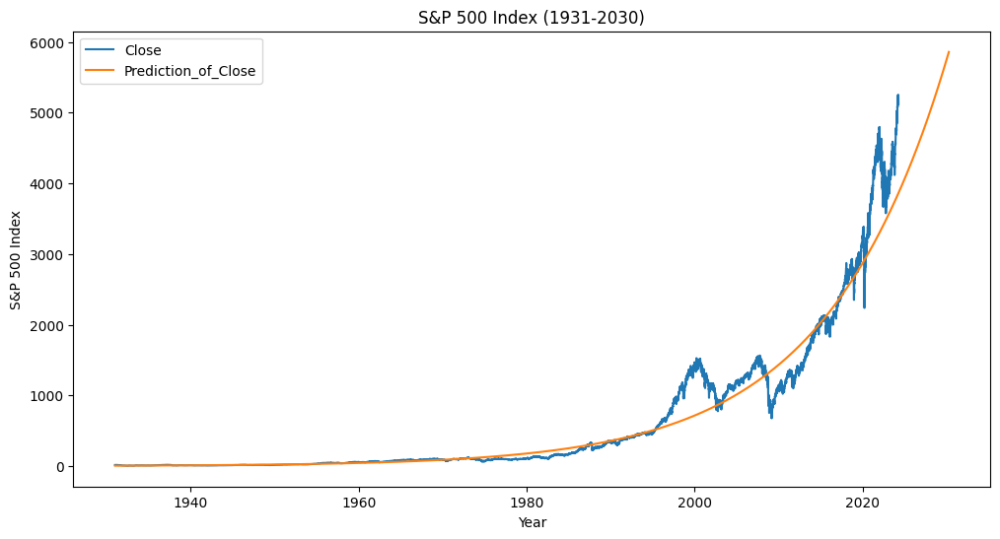

In [17]:
# plot the original data and the extended data
plt.figure(figsize=(12, 6))
sns.lineplot(x='Day', y='Close', data=extended_df, label='Close')
sns.lineplot(x='Day', y='Prediction_of_Close', data=extended_df, label='Prediction_of_Close')
plt.title(f'S&P 500 Index (1931-{year_future})')
plt.xlabel('Year')
plt.ylabel('S&P 500 Index')
plt.legend()
plt.show()


In [18]:
# D-Tale
d = dtale.show(df, host='localhost')   

## The Slope from 2009 looks different, let's fit a linear regression model to the data from 2009 to 2024

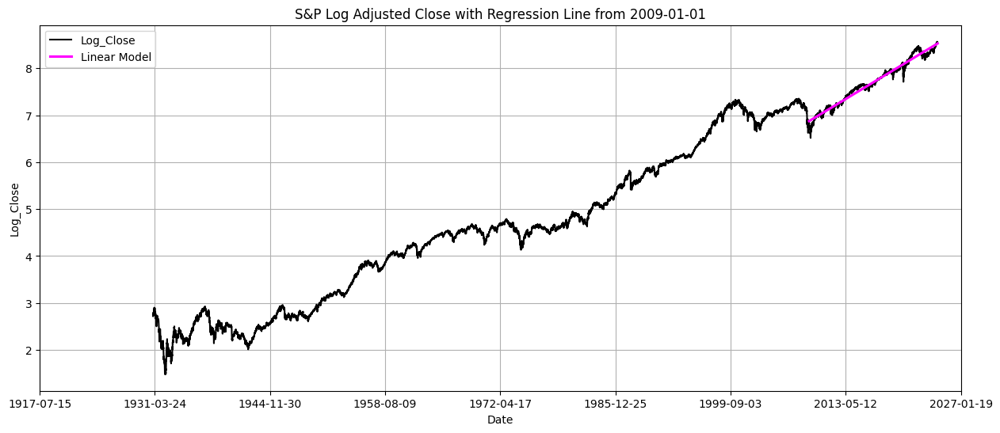

In [19]:


# convert the regression line start date to ordinal
x1 = pd.to_datetime('2009-01-01').toordinal()

# data slice for the regression line
data=df.loc[x1:].reset_index()

# plot the log Close data
ax1 = df.plot(y='Log_Close', c='k', figsize=(15, 6), grid=True, legend=False,
              title='S&P Log Adjusted Close with Regression Line from 2009-01-01')

# add a regression line
sns.regplot(data=data, x='Date', y='Log_Close', ax=ax1, color='magenta', scatter_kws={'s': 7}, label='Linear Model', scatter=False)

ax1.set_xlim(df.index[0], df.index[-1])

# convert the axis back to datetime
xticks = ax1.get_xticks()
labels = [pd.Timestamp.fromordinal(int(label)).date() for label in xticks]
ax1.set_xticks(xticks)
ax1.set_xticklabels(labels)

ax1.legend()

plt.show()


In [20]:
extended_df

,Open,High,Low,Close,Volume,Day,Log_Close,Prediction_of_Close,Day_od,Linear
704919,15.850000,15.850000,15.850000,15.850000,0.0,1931-01-02,2.763170,5.924283,704919,1.779060
704922,15.930000,15.930000,15.930000,15.930000,0.0,1931-01-05,2.768204,5.927664,704922,1.779630
704923,16.129999,16.129999,16.129999,16.129999,0.0,1931-01-06,2.780681,5.928792,704923,1.779820
704924,15.090000,15.090000,15.090000,15.090000,0.0,1931-01-07,2.714032,5.929919,704924,1.780011
704925,16.230000,16.230000,16.230000,16.230000,0.0,1931-01-08,2.786861,5.931047,704925,1.780201
...,...,...,...,...,...,...,...,...,...,...
741174,NaN,NaN,NaN,NaN,NaN,2030-04-07,NaN,5853.813797,741174,8.674849
741175,NaN,NaN,NaN,NaN,NaN,2030-04-08,NaN,5854.927312,741175,8.675039
741176,NaN,NaN,NaN,NaN,NaN,2030-04-09,NaN,5856.041039,741176,8.675229
741177,NaN,NaN,NaN,NaN,NaN,2030-04-10,NaN,5857.154978,741177,8.675419


In [21]:
# Chunk the extended data frame starting from 2009-05-01 
df_2009 = extended_df.loc[extended_df['Day'] >= pd.to_datetime('2009-05-01')]

#truncate df_2009 to the last day we have data in the close column  
df_2009 = df_2009.loc[df_2009['Close'].notnull()]


# Build a regression model to the log
model_2009 = LinearRegression()
model_2009.fit(df_2009[['Day_od']], df_2009['Log_Close'])

# Predict the close using the regression model
df_2009['2009_regr'] = np.exp(model_2009.predict(df_2009[['Day_od']]))

# Display the chunked data frame with the 2009_regr column for close
display(df_2009)


,Open,High,Low,Close,Volume,Day,Log_Close,Prediction_of_Close,Day_od,Linear,2009_regr
733528,872.739990,880.479980,866.099976,877.520020,5.312170e+09,2009-05-01,6.777100,1367.255728,733528,7.220561,1019.434774
733531,879.210022,907.849976,879.210022,907.239990,7.038840e+09,2009-05-04,6.810407,1368.036117,733531,7.221131,1020.327992
733532,906.099976,907.700012,897.340027,903.799988,6.882860e+09,2009-05-05,6.806608,1368.296346,733532,7.221322,1020.625904
733533,903.950012,920.280029,903.950012,919.530029,8.555040e+09,2009-05-06,6.823863,1368.556624,733533,7.221512,1020.923904
733534,919.580017,929.580017,901.359985,907.390015,9.120100e+09,2009-05-07,6.810572,1368.816951,733534,7.221702,1021.221991
...,...,...,...,...,...,...,...,...,...,...,...
738984,5211.370117,5219.569824,5197.350098,5202.390137,3.278180e+09,2024-04-08,8.556873,3859.547937,738984,8.258305,5013.057106
738985,5217.029785,5224.810059,5160.779785,5209.910156,3.400680e+09,2024-04-09,8.558318,3860.282102,738985,8.258496,5014.520807
738986,5167.879883,5178.430176,5138.700195,5160.640137,3.845930e+09,2024-04-10,8.548816,3861.016407,738986,8.258686,5015.984935
738987,5172.950195,5211.779785,5138.770020,5199.060059,3.509380e+09,2024-04-11,8.556233,3861.750852,738987,8.258876,5017.449490


In [22]:
#lets add 2009_regr to the extended_df
extended_df['2009_regr_prediction'] = np.exp(model_2009.predict(extended_df[['Day_od']]))

extended_df['2009_regr_linear'] = model_2009.predict(extended_df[['Day_od']])
display(extended_df)


,Open,High,Low,Close,Volume,Day,Log_Close,Prediction_of_Close,Day_od,Linear,2009_regr_prediction,2009_regr_linear
704919,15.850000,15.850000,15.850000,15.850000,0.0,1931-01-02,2.763170,5.924283,704919,1.779060,0.240517,-1.424966
704922,15.930000,15.930000,15.930000,15.930000,0.0,1931-01-05,2.768204,5.927664,704922,1.779630,0.240727,-1.424090
704923,16.129999,16.129999,16.129999,16.129999,0.0,1931-01-06,2.780681,5.928792,704923,1.779820,0.240798,-1.423798
704924,15.090000,15.090000,15.090000,15.090000,0.0,1931-01-07,2.714032,5.929919,704924,1.780011,0.240868,-1.423506
704925,16.230000,16.230000,16.230000,16.230000,0.0,1931-01-08,2.786861,5.931047,704925,1.780201,0.240938,-1.423214
...,...,...,...,...,...,...,...,...,...,...,...,...
741174,NaN,NaN,NaN,NaN,NaN,2030-04-07,NaN,5853.813797,741174,8.674849,9500.872873,9.159139
741175,NaN,NaN,NaN,NaN,NaN,2030-04-08,NaN,5854.927312,741175,8.675039,9503.646915,9.159431
741176,NaN,NaN,NaN,NaN,NaN,2030-04-09,NaN,5856.041039,741176,8.675229,9506.421768,9.159723
741177,NaN,NaN,NaN,NaN,NaN,2030-04-10,NaN,5857.154978,741177,8.675419,9509.197431,9.160015


In [26]:
# plot the exetennded data frame with the 2009_regr column using the plot_regression_line function
plot_regression_line(extended_df, equation, title=f'S&P 500 Index (1931-{year_future})', cols=['Day', 'Close', 'Prediction_of_Close', '2009_regr_prediction'],if_notebook=True, if_save=False, filename='Prediction_2030_S&P_500_Index.html')

Loading BokehJS ...

The plot is displayed in the notebook.


figure(id='p1583', ...)

In [24]:
#calculate percentage of yearly growth of the S&P 500 index per year for 3 different coumns close, prediction_of_close and 2009_regr_prediction
# calculate the percentage of yearly growth
extended_df['Close_pct'] = extended_df['Close'].pct_change() * 100
extended_df['Prediction_of_Close_pct'] = extended_df['Prediction_of_Close'].pct_change() * 100
extended_df['2009_regr_prediction_pct'] = extended_df['2009_regr_prediction'].pct_change() * 100

# Display the extended data frame with the percentage columns
display(extended_df.iloc[:, :])



/var/folders/br/wrxwtyg562xdsw7_qcksrtg80000gn/T/ipykernel_45707/3565321510.py:3: FutureWarning:

The default fill_method='pad' in Series.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.



,Open,High,Low,Close,Volume,Day,Log_Close,Prediction_of_Close,Day_od,Linear,2009_regr_prediction,2009_regr_linear,Close_pct,Prediction_of_Close_pct,2009_regr_prediction_pct
704919,15.850000,15.850000,15.850000,15.850000,0.0,1931-01-02,2.763170,5.924283,704919,1.779060,0.240517,-1.424966,NaN,NaN,NaN
704922,15.930000,15.930000,15.930000,15.930000,0.0,1931-01-05,2.768204,5.927664,704922,1.779630,0.240727,-1.424090,0.504731,0.057077,0.087619
704923,16.129999,16.129999,16.129999,16.129999,0.0,1931-01-06,2.780681,5.928792,704923,1.779820,0.240798,-1.423798,1.255486,0.019022,0.029198
704924,15.090000,15.090000,15.090000,15.090000,0.0,1931-01-07,2.714032,5.929919,704924,1.780011,0.240868,-1.423506,-6.447607,0.019022,0.029198
704925,16.230000,16.230000,16.230000,16.230000,0.0,1931-01-08,2.786861,5.931047,704925,1.780201,0.240938,-1.423214,7.554668,0.019022,0.029198
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
741174,NaN,NaN,NaN,NaN,NaN,2030-04-07,NaN,5853.813797,741174,8.674849,9500.872873,9.159139,0.000000,0.019022,0.029198
741175,NaN,NaN,NaN,NaN,NaN,2030-04-08,NaN,5854.927312,741175,8.675039,9503.646915,9.159431,0.000000,0.019022,0.029198
741176,NaN,NaN,NaN,NaN,NaN,2030-04-09,NaN,5856.041039,741176,8.675229,9506.421768,9.159723,0.000000,0.019022,0.029198
741177,NaN,NaN,NaN,NaN,NaN,2030-04-10,NaN,5857.154978,741177,8.675419,9509.197431,9.160015,0.000000,0.019022,0.029198


In [ ]:
#show data using dtale
d = dtale.show(extended_df, host='localhost')


In [ ]:
# print yearly growth of the S&P 500 index per year in 2023 for 3 different columns close, prediction_of_close and 2009_regr_prediction
year_future = 2024

print(f'Yearly growth of the S&P 500 index per year in {year_future} for 3 different columns:')
print(f'Prediction_of_Close: {100*extended_df.loc[extended_df["Day"] == "2025-01-01", "Prediction_of_Close"].values[0]/extended_df.loc[extended_df["Day"] == "2026-01-01", "Prediction_of_Close"].values[0]:.2f}%')

print(f'Prediction_of_Close: {extended_df.loc[extended_df["Day"] == "2026-01-01", "Prediction_of_Close"].values[0]}')
print(f'Prediction_of_Close: {extended_df.loc[extended_df["Day"] == "2025-01-01", "Prediction_of_Close"].values[0]}')

print(f'2009_regr_prediction: {extended_df.loc[extended_df["Day"] == "2026-01-01", "2009_regr_prediction"].values[0]}')
print(f'2009_regr_prediction: {extended_df.loc[extended_df["Day"] == "2025-01-01", "2009_regr_prediction"].values[0]}')

print(f'Prediction_of_Close: {100*extended_df.loc[extended_df["Day"] == "2025-01-01", "2009_regr_prediction"].values[0]/extended_df.loc[extended_df["Day"] == "2026-01-01", "2009_regr_prediction"].values[0]:.2f}%')

print(extended_df.loc[extended_df["Day"] == "2023-02-01", "Close"])
print(extended_df.loc[extended_df["Day"] == "2024-02-01", "Close"])

print(f'Close: {100*extended_df.loc[extended_df["Day"] == "2023-02-01", "Close"].values[0]/extended_df.loc[extended_df["Day"] == "2024-02-01", "Close"].values[0]:.2f}%')




Yearly growth of the S&P 500 index per year in 2024 for 3 different columns:
Prediction_of_Close: 93.29%
Prediction_of_Close: 4352.228042867148
Prediction_of_Close: 4060.345789909531
2009_regr_prediction: 6029.357863817779
2009_regr_prediction: 5420.029958439872
Prediction_of_Close: 89.89%
738552    4119.209961
Name: Close, dtype: float64
738917    4906.189941
Name: Close, dtype: float64
Close: 83.96%


## We will be calculating left and right gradient quitoents

### check a slice of data in range of delta_days from today


In [ ]:
# check a slice of data in range of delta_days from today

df_2 = df.copy().sort_index(ascending=True)

print(df_2.shape)

# display df_2 for 5 days before and after today
delta_days = 5
# date_range = (df_2.Day > pd.to_datetime(today) - pd.DateOffset(days=delta_days)) & (df_2.Day < pd.to_datetime(today) + pd.DateOffset(days=delta_days))

date_range = (df_2.Day > pd.to_datetime(today) - pd.DateOffset(days=delta_days)) & (df_2.Day < pd.to_datetime(today) + pd.DateOffset(days=delta_days))

print(pd.to_datetime(today) - pd.DateOffset(days=delta_days))
print(pd.to_datetime(today) + pd.DateOffset(days=delta_days))


print(df_2[df_2.Day > pd.to_datetime(today) - pd.DateOffset(days=delta_days)])

print(date_range.sum())

# display(df_2.loc[date_range].iloc[:, :])


(23430, 7)
2024-04-01 00:00:00
2024-04-11 00:00:00
               Open         High          Low        Close      Volume  \
Date                                                                     
738978  5204.290039  5208.339844  5184.049805  5205.810059  3886590000   
738979  5194.370117  5228.750000  5194.370117  5211.490234  3703250000   
738980  5244.049805  5256.589844  5146.060059  5147.209961  4075680000   
738981  5158.950195  5222.180176  5157.209961  5204.339844  3386780000   

              Day  Log_Close  
Date                          
738978 2024-04-02   8.557531  
738979 2024-04-03   8.558621  
738980 2024-04-04   8.546210  
738981 2024-04-05   8.557248  
4


### Calculating the right gradient quotient, first will caclulate the minimum from the day forward

In [ ]:


# spot check for a random index
i=10000

print ('i = ',i, '\n', df_2.loc[df_2.index[i], :], '\n ',)


print(df_2['Close'][i:].shape ,'\n ' , df_2['Close'][i:].min() ) 

#print the index of the min value and double check
print(df_2['Close'][i:].idxmin())
print(df_2.loc[720899,'Close'])

#print the index of the max prior value and double check
print(df_2['Close'][:i].shape ,'\n ' , df_2['Close'][:i].max() )
print(df_2['Close'][:i].idxmax())
print(df_2.loc[718765,'Close'])



# calcualte the number of days between the i and the min value using the day column
print(df_2.Day.iloc[i])
print(df_2.Day.loc[720899])


# print the number of days between the i and the min value using the day column
print((df_2.Day.loc[720899] - df_2.Day.iloc[i]).days)

# calcualte the number of days between the i and the max value using the day column
print((df_2.Day.loc[718765] - df_2.Day.iloc[i]).days)




i =  10000 
 Open                                    0.0
High                              92.279999
Low                               90.690002
Close                             91.800003
Volume                             12600000
Day                     1971-01-05 00:00:00
Log_Close                          4.519612
Min_After_Close                   62.279999
Min_After_Close_Date             1974-10-03
Max_Prior_Close                  108.370003
Max_Prior_Close_Date             1968-11-29
Name: 719532, dtype: object 
 
(13430,) 
  62.279998779296875
720899
62.279998779296875
(10000,) 
  108.37000274658205
718765
108.37000274658205
1971-01-05 00:00:00
1974-10-03 00:00:00
1367
-767


In [ ]:
# add the min and max columns to the dataframe


# add a column for each day of close, calculate the min of the close column 
# # starting next day and till the end of the dataframe
# # add a column for each day of close, calculate the max of the close column for all days before the current day


for i in range(1, len(df_2)):
    df_2.loc[df_2.index[i], 'Min_After_Close'] = df_2['Close'][i:].min()
    #add the date the min was found
    df_2.loc[df_2.index[i], 'Min_After_Close_Date'] = df_2[df_2['Close'] == df_2['Close'][i:].min()]['Day'].min().date()
    #the number of days between the i and the min value using the day column
    df_2.loc[df_2.index[i], 'Days_to_Min'] = (df_2['Day'].loc[df_2['Close'] == df_2['Close'][i:].min()].min() - df_2['Day'].iloc[i]).days

    df_2.loc[df_2.index[i], 'Max_Prior_Close'] = df_2['Close'][:i].max()
    #add the date the max was found, use the Day column to get the date
    df_2.loc[df_2.index[i], 'Max_Prior_Close_Date'] = df_2[df_2['Close'] == df_2['Close'][:i].max()]['Day'].min().date()
    # add the number of days between the i and the max value using the day column
    df_2.loc[df_2.index[i], 'Days_to_Max'] = (df_2['Day'].loc[df_2['Close'] == df_2['Close'][:i].max()].min() - df_2['Day'].iloc[i]).days

display(df_2.tail(10))



               Open         High          Low        Close      Volume  \
Date                                                                     
738967  5242.479980  5246.089844  5229.870117  5234.180176  3374700000   
738970  5219.520020  5229.089844  5216.089844  5218.189941  3331360000   
738971  5228.850098  5235.160156  5203.419922  5203.580078  3871790000   
738972  5226.310059  5249.259766  5213.919922  5248.490234  3850500000   
738973  5248.029785  5264.850098  5245.819824  5254.350098  3998270000   
738977  5257.970215  5263.950195  5229.200195  5243.770020  3325930000   
738978  5204.290039  5208.339844  5184.049805  5205.810059  3886590000   
738979  5194.370117  5228.750000  5194.370117  5211.490234  3703250000   
738980  5244.049805  5256.589844  5146.060059  5147.209961  4075680000   
738981  5158.950195  5222.180176  5157.209961  5204.339844  3386780000   

              Day  Log_Close  Min_After_Close Min_After_Close_Date  \
Date                                     

In [ ]:
display(df_2.tail(10))


,Open,High,Low,Close,Volume,Day,Log_Close,Min_After_Close,Min_After_Close_Date,Max_Prior_Close,Max_Prior_Close_Date
Date,,,,,,,,,,,
738967,5242.479980,5246.089844,5229.870117,5234.180176,3374700000,2024-03-22,8.562966,5147.209961,2024-04-04,5241.529785,2024-03-21
738970,5219.520020,5229.089844,5216.089844,5218.189941,3331360000,2024-03-25,8.559906,5147.209961,2024-04-04,5241.529785,2024-03-21
738971,5228.850098,5235.160156,5203.419922,5203.580078,3871790000,2024-03-26,8.557102,5147.209961,2024-04-04,5241.529785,2024-03-21
738972,5226.310059,5249.259766,5213.919922,5248.490234,3850500000,2024-03-27,8.565696,5147.209961,2024-04-04,5241.529785,2024-03-21
738973,5248.029785,5264.850098,5245.819824,5254.350098,3998270000,2024-03-28,8.566812,5147.209961,2024-04-04,5248.490234,2024-03-27
738977,5257.970215,5263.950195,5229.200195,5243.770020,3325930000,2024-04-01,8.564796,5147.209961,2024-04-04,5254.350098,2024-03-28
738978,5204.290039,5208.339844,5184.049805,5205.810059,3886590000,2024-04-02,8.557531,5147.209961,2024-04-04,5254.350098,2024-03-28
738979,5194.370117,5228.750000,5194.370117,5211.490234,3703250000,2024-04-03,8.558621,5147.209961,2024-04-04,5254.350098,2024-03-28
738980,5244.049805,5256.589844,5146.060059,5147.209961,4075680000,2024-04-04,8.546210,5147.209961,2024-04-04,5254.350098,2024-03-28


### putting it all together into a function

In [ ]:
# add a column for each day of close, calculate the min of the close column 
#     starting next day and till the end of the dataframe
#     add a column for each day of close, calculate the max of the close column for all days before the current day
#     add a column for the number of days from the current day to the day the min was found
#     add a column for the number of days from the current day to the day the max was found

# let's put the above code in a function

def min_max_close(df):
    '''
    add a column for each day of close, calculate the min of the close column 
    starting next day and till the end of the dataframe
    add a column for each day of close, calculate the max of the close column for all days before the current day
    add a column for the number of days from the current day to the day the min was found
    add a column for the number of days from the current day to the day the max was found
    '''
    for i in range(1, len(df)):
        df.loc[df.index[i], 'Min_After_Close'] = df['Close'][i:].min()
        df.loc[df.index[i], 'Min_After_Close_Date'] = df[df['Close'] == df['Close'][i:].min()]['Day'].min().date()
        #the number of days between the i and the min value using the day column
        df.loc[df.index[i], 'Days_to_Min'] = (df['Day'].loc[df['Close'] == df['Close'][i:].min()].min() - df['Day'].iloc[i]).days


        df.loc[df.index[i], 'Max_Prior_Close'] = df['Close'][:i].max()
        df.loc[df.index[i], 'Max_Prior_Close_Date'] = df[df['Close'] == df['Close'][:i].max()]['Day'].min().date()
        # add the number of days between the i and the max value using the day column
        df.loc[df.index[i], 'Days_to_Max'] = (df['Day'].loc[df['Close'] == df['Close'][:i].max()].min() - df['Day'].iloc[i]).days

    return df

df_3 = min_max_close(df_2)

In [ ]:
display (df_3.iloc[:, :].tail(30))

,Open,High,Low,Close,Volume,Day,Log_Close,Min_After_Close,Min_After_Close_Date,Max_Prior_Close,Max_Prior_Close_Date,Days_to_Min,Days_to_Max
Date,,,,,,,,,,,,,
738939,5100.919922,5111.060059,5081.459961,5088.799805,3672790000,2024-02-23,8.534797,5069.529785,2024-02-26,5087.029785,2024-02-22,3.0,-1.0
738942,5093.000000,5097.660156,5068.910156,5069.529785,3683930000,2024-02-26,8.531003,5069.529785,2024-02-26,5088.799805,2024-02-23,0.0,-3.0
738943,5074.600098,5080.689941,5057.290039,5078.180176,3925950000,2024-02-27,8.532708,5069.759766,2024-02-28,5088.799805,2024-02-23,1.0,-4.0
738944,5067.200195,5077.370117,5058.350098,5069.759766,3789370000,2024-02-28,8.531049,5069.759766,2024-02-28,5088.799805,2024-02-23,0.0,-5.0
738945,5085.359863,5104.990234,5061.890137,5096.270020,5219740000,2024-02-29,8.536264,5078.649902,2024-03-05,5088.799805,2024-02-23,5.0,-6.0
738946,5098.509766,5140.330078,5094.160156,5137.080078,4748110000,2024-03-01,8.544240,5078.649902,2024-03-05,5096.270020,2024-02-29,4.0,-1.0
738949,5130.990234,5149.669922,5127.180176,5130.950195,4758440000,2024-03-04,8.543046,5078.649902,2024-03-05,5137.080078,2024-03-01,1.0,-3.0
738950,5110.520020,5114.540039,5056.819824,5078.649902,4418410000,2024-03-05,8.532801,5078.649902,2024-03-05,5137.080078,2024-03-01,0.0,-4.0
738951,5108.029785,5127.970215,5092.220215,5104.759766,4559050000,2024-03-06,8.537929,5104.759766,2024-03-06,5137.080078,2024-03-01,0.0,-5.0


In [ ]:
# using the plot_regression_line function to plot the min and max close columns
plot_regression_line(df_3, equation, title='S&P 500 Index (1931-2024)', cols=['Day', 'Close', 'Min_After_Close', 'Max_Prior_Close'], if_notebook=True, if_save=False, filename='Min_Max_Close.html')


Loading BokehJS ...

The plot is displayed in the notebook.


figure(id='p1469', ...)

In [ ]:
### let's iedntify the min and max values for the close column for a time window of 365 days
# add a column for each day of close, calculate the min of the close column
#     starting next day and till the end of the dataframe
#     add a column for each day of close, calculate the max of the close column for all days before the current day
#     add a column for the number of days from the current day to the day the min was found
#     add a column for the number of days from the current day to the day the max was found
#     add a column for the number of days from the current day to the day the min was found in the last 365 days
#     add a column for the number of days from the current day to the day the max was found in the last 365 days

def min_max_close_365(df):
    '''
    add a column for each day of close, calculate the min of the close column 
    starting next day and till the end of the dataframe
    add a column for each day of close, calculate the max of the close column for all days before the current day
    add a column for the number of days from the current day to the day the min was found
    add a column for the number of days from the current day to the day the max was found
    add a column for the number of days from the current day to the day the min was found in the last 365 days
    add a column for the number of days from the current day to the day the max was found in the last 365 days
    '''
    for i in range(1, len(df)):
        df.loc[df.index[i], 'Min_After_Close'] = df['Close'][i:].min()
        df.loc[df.index[i], 'Min_After_Close_Date'] = df[df['Close'] == df['Close'][i:].min()]['Day'].min().date()
        #the number of days between the i and the min value using the day column
        df.loc[df.index[i], 'Days_to_Min'] = (df['Day'].loc[df['Close'] == df['Close'][i:].min()].min() - df['Day'].iloc[i]).days


        df.loc[df.index[i], 'Max_Prior_Close'] = df['Close'][:i].max()
        df.loc[df.index[i], 'Max_Prior_Close_Date'] = df[df['Close'] == df['Close'][:i].max()]['Day'].min().date()
        # add the number of days between the i and the max value using the day column
        df.loc[df.index[i], 'Days_to_Max'] = (df['Day'].loc[df['Close'] == df['Close'][:i].max()].min() - df['Day'].iloc[i]).days

        df.loc[df.index[i], 'Min_After_Close_365'] = df['Close'][i:i+365].min()
        df.loc[df.index[i], 'Min_After_Close_Date_365'] = df[df['Close'] == df['Close'][i:i+365].min()]['Day'].min().date()
        #the number of days between the i and the min value using the day column
        df.loc

        df.loc[df.index[i], 'Max_Prior_Close_365'] = df['Close'][i-365:i].max()

        df.loc[df.index[i], 'Max_Prior_Close_Date_365'] = df[df['Close'] == df['Close'][i-365:i].max()]['Day'].min().date()
        # add the number of days between the i and the max value using the day column
        df.loc[df.index[i], 'Days_to_Max_365'] = (df['Day'].loc[df['Close'] == df['Close'][i-365:i].max()].min() - df['Day'].iloc[i]).days
        
    return df



df_4 = min_max_close_365(df_2)
#display(df_4.iloc[:, :].tail(30))

/var/folders/br/wrxwtyg562xdsw7_qcksrtg80000gn/T/ipykernel_9073/3091509755.py:39: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1931-02-24' has dtype incompatible with datetime64[ns], please explicitly cast to a compatible dtype first.



,Open,High,Low,Close,Volume,Day,Log_Close,Min_After_Close,Min_After_Close_Date,Max_Prior_Close,Max_Prior_Close_Date,Days_to_Min,Days_to_Max,Min_After_Close_365,Min_After_Close_Date_365,Max_Prior_Close_365,Max_Prior_Close_Date_365,Days_to_Max_365
Date,,,,,,,,,,,,,,,,,,
738939,5100.919922,5111.060059,5081.459961,5088.799805,3672790000,2024-02-23,8.534797,5069.529785,2024-02-26,5087.029785,2024-02-22,3.0,-1.0,5069.529785,2024-02-26,5087.029785,2024-02-22,-1.0
738942,5093.000000,5097.660156,5068.910156,5069.529785,3683930000,2024-02-26,8.531003,5069.529785,2024-02-26,5088.799805,2024-02-23,0.0,-3.0,5069.529785,2024-02-26,5088.799805,2024-02-23,-3.0
738943,5074.600098,5080.689941,5057.290039,5078.180176,3925950000,2024-02-27,8.532708,5069.759766,2024-02-28,5088.799805,2024-02-23,1.0,-4.0,5069.759766,2024-02-28,5088.799805,2024-02-23,-4.0
738944,5067.200195,5077.370117,5058.350098,5069.759766,3789370000,2024-02-28,8.531049,5069.759766,2024-02-28,5088.799805,2024-02-23,0.0,-5.0,5069.759766,2024-02-28,5088.799805,2024-02-23,-5.0
738945,5085.359863,5104.990234,5061.890137,5096.270020,5219740000,2024-02-29,8.536264,5078.649902,2024-03-05,5088.799805,2024-02-23,5.0,-6.0,5078.649902,2024-03-05,5088.799805,2024-02-23,-6.0
738946,5098.509766,5140.330078,5094.160156,5137.080078,4748110000,2024-03-01,8.544240,5078.649902,2024-03-05,5096.270020,2024-02-29,4.0,-1.0,5078.649902,2024-03-05,5096.270020,2024-02-29,-1.0
738949,5130.990234,5149.669922,5127.180176,5130.950195,4758440000,2024-03-04,8.543046,5078.649902,2024-03-05,5137.080078,2024-03-01,1.0,-3.0,5078.649902,2024-03-05,5137.080078,2024-03-01,-3.0
738950,5110.520020,5114.540039,5056.819824,5078.649902,4418410000,2024-03-05,8.532801,5078.649902,2024-03-05,5137.080078,2024-03-01,0.0,-4.0,5078.649902,2024-03-05,5137.080078,2024-03-01,-4.0
738951,5108.029785,5127.970215,5092.220215,5104.759766,4559050000,2024-03-06,8.537929,5104.759766,2024-03-06,5137.080078,2024-03-01,0.0,-5.0,5104.759766,2024-03-06,5137.080078,2024-03-01,-5.0


In [ ]:
# let's plot the min and max close columns for the last 365 days using the plot_regression_line function
plot_regression_line(df_4, equation, title='S&P 500 Index (1931-2024)', cols=['Day', 'Close', 'Min_After_Close_365', 'Max_Prior_Close_365'], if_notebook=True, if_save=False, filename='Min_Max_Close_365.html')

Loading BokehJS ...

The plot is displayed in the notebook.


figure(id='p1665', ...)

In [ ]:
### let's identify local min and max values 


In [ ]:
### let's identify local min and max values 


In [ ]:
# let's use pandas_bokeh
import pandas as pd
import pandas_bokeh
pandas_bokeh.output_notebook()

ModuleNotFoundError: No module named 'pandas_bokeh'